In [10]:
import yfinance as yf
import pandas as pd
import numpy as np
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
import scipy.stats as ss
from scipy.stats import norm

# Starting with Anomaly detection on weekly data

### Assemble stock data from yahoo finance

In [13]:
stocks = ['META', 'MSFT', 'XOM', '^GSPC'] # Meta, Microsoft, Exxon Mobil, S&P500 index

start_date = '2013-01-01' # META is missing data before May 2012, no NAs after
end_date = '2024-12-31'
data = yf.download(stocks, start=start_date, end=end_date)


[*********************100%***********************]  1 of 1 completed

1 Failed download:
['META']: YFRateLimitError('Too Many Requests. Rate limited. Try after a while.')


In [3]:
# COlumn structure, and confirm no NAs
data.isna().sum()

Price      Ticker
Adj Close  META      0
           MSFT      0
           XOM       0
           ^GSPC     0
Close      META      0
           MSFT      0
           XOM       0
           ^GSPC     0
High       META      0
           MSFT      0
           XOM       0
           ^GSPC     0
Low        META      0
           MSFT      0
           XOM       0
           ^GSPC     0
Open       META      0
           MSFT      0
           XOM       0
           ^GSPC     0
Volume     META      0
           MSFT      0
           XOM       0
           ^GSPC     0
dtype: int64

### Preprocessing of stock data
- For the given daily stock data, we will smooth it using moving average over 5 days, then make it weekly.
- Then we will log-transform the data and use the change for each week
- We will further standardize the log-transformed changes so that we can compare across the symbols as well
- Lastly we will visualize the normality and outliers using histograms and Q-Q plots to see if the log-transformed changes are appropriate to use for further analysis


In [4]:
# Apply rolling average over 5 days centered at each day
data_smooth = data.rolling(window=5, min_periods=1).mean()

# Resample to weekly and aggregate by mean
weekly_df = data_smooth.resample('W').mean().iloc[1:-1]

# Using log-transformed changes
log_changes = np.log(weekly_df / weekly_df.shift(1)).dropna()
# Standardize
log_changes = (log_changes - log_changes.mean())/log_changes.std()

In [8]:
data

Empty DataFrame
Columns: [(Adj Close, META), (Adj Close, MSFT), (Adj Close, XOM), (Adj Close, ^GSPC), (Close, META), (Close, MSFT), (Close, XOM), (Close, ^GSPC), (High, META), (High, MSFT), (High, XOM), (High, ^GSPC), (Low, META), (Low, MSFT), (Low, XOM), (Low, ^GSPC), (Open, META), (Open, MSFT), (Open, XOM), (Open, ^GSPC), (Volume, META), (Volume, MSFT), (Volume, XOM), (Volume, ^GSPC)]
Index: []

[0 rows x 24 columns]

Visualizing the distribution of log changes (first overall, then year-wise)

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

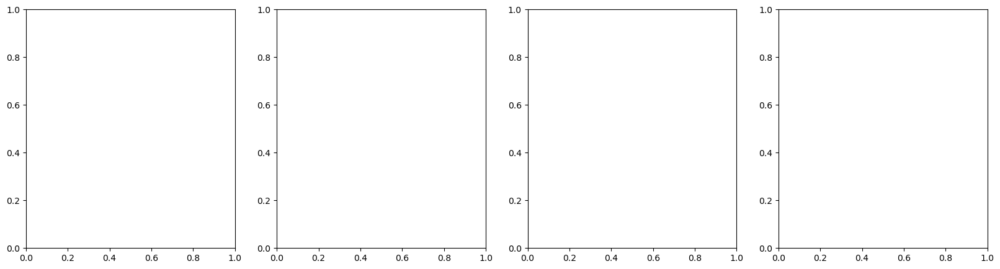

In [5]:
years = log_changes.index.year.unique()
Ny = len(years)
symbols = log_changes["Close"].columns

fig, axes = plt.subplots(Ny+1, len(symbols), figsize=(20, 5 * (Ny+1)), sharex=True)

for j, symbol in enumerate(symbols):
    for i, year in enumerate(years):
        ax = axes[i, j]
        yearly_data = log_changes["Close"].loc[str(year), symbol].dropna()

        ax.hist(yearly_data, bins=30, alpha=0.7, color='blue', edgecolor='black')
        ax.set_title(f"{symbol} - {year}")
        ax.grid(True)
    # Plot for all years 2013-2024
    ax = axes[Ny, j]
    all_data = log_changes["Close"].loc[:, symbol].dropna()

    ax.hist(all_data, bins=30, alpha=0.7, color='blue', edgecolor='black')
    ax.set_title(f"{symbol} - 2013-2024")
    ax.grid(True)

plt.xlabel("Log Change")
plt.tight_layout()
plt.show()

Log-transformed changes look mostly unimodal (except for 2020, the year of pandemic shutdown) but it could be heavy-tailed
Checking distribution of log-transformed changes through q-q plots

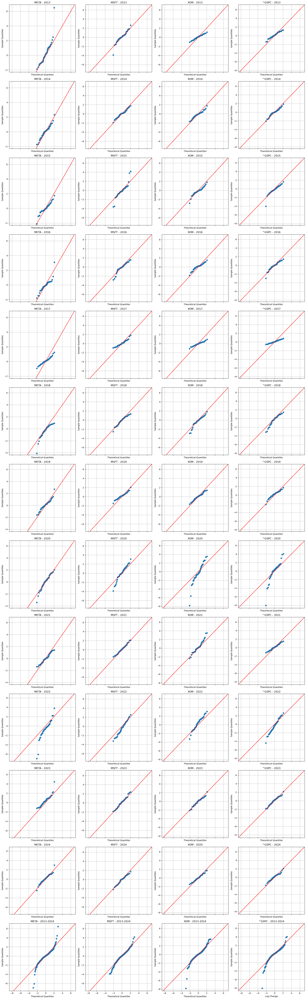

In [ ]:
years = log_changes.index.year.unique()
Ny = len(years)
symbols = log_changes["Close"].columns

fig, axes = plt.subplots(Ny+1, len(symbols), figsize=(20, 5 * (Ny+1)), sharex=True)

for j, symbol in enumerate(symbols):
    for i, year in enumerate(years):
        ax = axes[i, j]
        yearly_data = log_changes["Close"].loc[str(year), symbol].dropna()

        sm.qqplot(yearly_data, line='45', ax = ax)
        ax.set_title(f"{symbol} - {year}")
        ax.grid(True)

    # Plot for all years 2013-2024
    ax = axes[Ny, j]
    all_data = log_changes["Close"].loc[:, symbol].dropna()

    sm.qqplot(all_data, line='45', ax = ax)
    ax.set_title(f"{symbol} - 2013-2024")
    ax.grid(True)


# Set labels
plt.xlabel("Log Change")
plt.tight_layout()
plt.show()

In [ ]:
dist = getattr(ss,'norm')

In [ ]:
norm.cdf(-2)

np.float64(0.022750131948179198)

In [ ]:
norm.ppf(0.25)

np.float64(-0.6744897501960817)

Q-Q plots of the log changes in closing price (averaged weekly) for each stock for each year as well as all years combined (in the last row).

Q-Q plots lie mostly on the diagonal, except for some years such as 2020 (the year of oandemic shutdown). However, the plots deviate from the diagonal near the extreme ends. Thus, we have heavy-tailed distribution.

Thus, it will be interesting to discover such anomolous periods, and connect with the real-world events.

Since we are interested in the the outlier events, we can make a background normal distribution using the median of the observed data as mean and setting the standard deviation such that interquantile range matches the observed one.

In [ ]:
# IQR range
IQRs = np.array([np.percentile(log_changes["Close"].loc[:,t], 75) - np.percentile(log_changes["Close"].loc[:,t], 25) for t in symbols])
for t,std in zip(symbols,np.round(IQRs,3)):
    print(t,std)

META 0.935
MSFT 1.066
XOM 0.929
^GSPC 0.965


Since IQR of standard normal is $ 1.349\sigma $, we use the $\sigma$ of our background normal distribution to be IQR / 1.349.
Since log chages were standardized, we will use 0 as mean for the background.

In [ ]:
bg_std = dict(zip(symbols,IQRs / 1.349))
bg_mean = {t:log_changes["Close"].loc[:,t].median() for t in symbols}
for t in symbols:
    print(t)
    print("Background mean (based on on IQR) = ", np.round(bg_mean[t],3))
    print("Background std. (based on on IQR) = ", np.round(bg_std[t],3))


META
Background mean (based on on IQR) =  0.02
Background std. (based on on IQR) =  0.693
MSFT
Background mean (based on on IQR) =  0.047
Background std. (based on on IQR) =  0.79
XOM
Background mean (based on on IQR) =  0.031
Background std. (based on on IQR) =  0.689
^GSPC
Background mean (based on on IQR) =  0.08
Background std. (based on on IQR) =  0.715


In [ ]:
def BH_cutoff(pvals,alpha):
    pvals = np.sort(pvals)
    meet_crit = pvals<np.arange(1,len(pvals)+1)/len(pvals)*alpha
    if meet_crit.sum()==0:
        return 0
    return pvals[np.ravel(np.argwhere(meet_crit))[-1]]



def marcenko_pastur_density(n,p):
    # n = samples, p = features
    q = p / n  # Aspect ratio (p/n)
    lambda_min = (1 - np.sqrt(q))**2
    lambda_max = (1 + np.sqrt(q))**2
    lambda_vals = np.linspace(lambda_min, lambda_max, 1000)
    def marcenko_pastur_pdf(lambda_val, q):
        if lambda_min <= lambda_val <= lambda_max:
            return (1 / (2 * np.pi * q * lambda_val)) * np.sqrt((lambda_max - lambda_val) * (lambda_val - lambda_min))
        else:
            return 0
    mp_density = np.array([marcenko_pastur_pdf(l, q) for l in lambda_vals])
    return lambda_vals,mp_density

# BH_cutoff([0.05/6,0.06/6,0.07/6,0.01/6,0.03/6],0.05)

<Figure size 640x480 with 0 Axes>

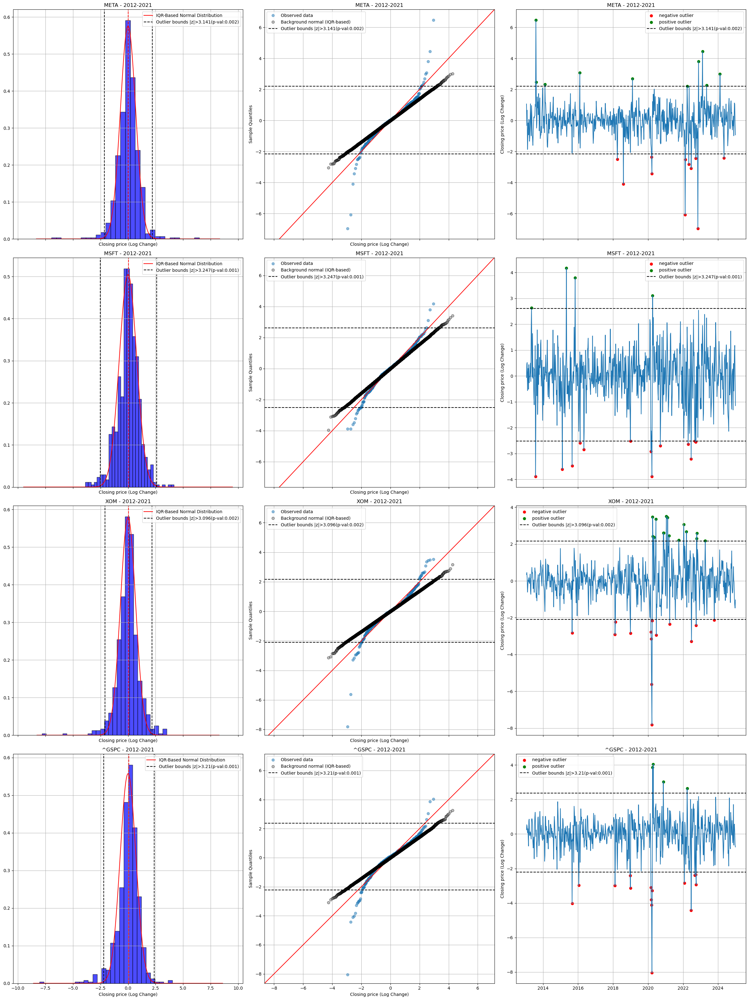

In [ ]:
pval_thr = 0.05
low_anomalies = dict()
high_anomalies = dict()
plt.clf()
fig, axes = plt.subplots(len(symbols),3, figsize=(8*3, 4*8), sharex = 'col')

for j,t in enumerate(symbols):
    # make background dist
    mean = bg_mean[t]
    std = bg_std[t]
    x = np.linspace(-12*std,12*std, 300)
    pdf = ss.norm.pdf(x, loc=0, scale=std)

    # finding anomalies
    z_scores = (log_changes["Close"].loc[:,t] - mean) / std
    pvals = ss.norm.cdf(-np.abs(z_scores))*2
    z_thr = np.abs(ss.norm.ppf(BH_cutoff(pvals,pval_thr)/2))
    low_anomalies[t] = z_scores < -z_thr
    high_anomalies[t] = z_scores > z_thr
    

    # plot observed and background dist
    ax = axes[j][0]
    ax.hist(log_changes["Close"].loc[:,t], bins=30, alpha=0.7, color='blue', edgecolor='black', density=True)
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(mean, color='r', linestyle="--")
    ax.axvline(z_thr*std + mean, color='k', linestyle="--", label=f"Outlier bounds |z|>{np.round(z_thr,3)}(p-val:{np.round(ss.norm.cdf(-np.abs(z_thr))*2,3)})")
    ax.axvline(-z_thr*std + mean, color='k', linestyle="--")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()

    ## qqplot of same
    ax = axes[j][1]
    sm.qqplot(log_changes["Close"].loc[:,t], line='45', ax = ax, alpha = 0.5, label = "Observed data")
    sm.qqplot(np.random.normal(loc=0, scale=std, size=100000), ax = ax, alpha = 0.5, label = "Background normal (IQR-based)", markerfacecolor='gray', markeredgecolor='black')
    ax.axhline(-z_thr*std + mean, color='k', linestyle="--", label=f"Outlier bounds |z|>{np.round(z_thr,3)}(p-val:{np.round(ss.norm.cdf(-np.abs(z_thr))*2,3)})")
    ax.axhline(z_thr*std + mean, color='k', linestyle="--")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()
    
    # plot anomalies on actual prices
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,t])
    ax.scatter(log_changes.index[low_anomalies[t]],log_changes["Close"].loc[low_anomalies[t],t], color = "red",label = "negative outlier")
    ax.scatter(log_changes.index[high_anomalies[t]],log_changes["Close"].loc[high_anomalies[t],t], color = "green",label = "positive outlier")
    ax.axhline(-z_thr*std + mean, color='k', linestyle="--", label=f"Outlier bounds |z|>{np.round(z_thr,3)}(p-val:{np.round(ss.norm.cdf(-np.abs(z_thr))*2,3)})")
    ax.axhline(z_thr*std + mean, color='k', linestyle="--")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

plt.tight_layout()
plt.show()

As expected, the background normal distribution made using IQR of the observed data is very close to the observed data in the middle, but the observed data has heavier tails. The qq-plot of the background normal distribution appears as a straight line but less steep than $45\degree$ since the standard deviation is less than 1.

Using the background normal distribution, we found anomalies as outside z-score threshold = 3 (in magnitude).

Bivariate analysis
- Use PCs 1/rt2,
- Bivaritre dist.
- PC project
- Find outliers using IQR

- test stat = Mahalanobis distance^2, distrib = chi-sq => p-value (Multiple Hyp.)

- Using outisde a certain range (and then adjust the background distribution, might help with multiple correction)
- play with the threshold


In [ ]:
import seaborn as sns

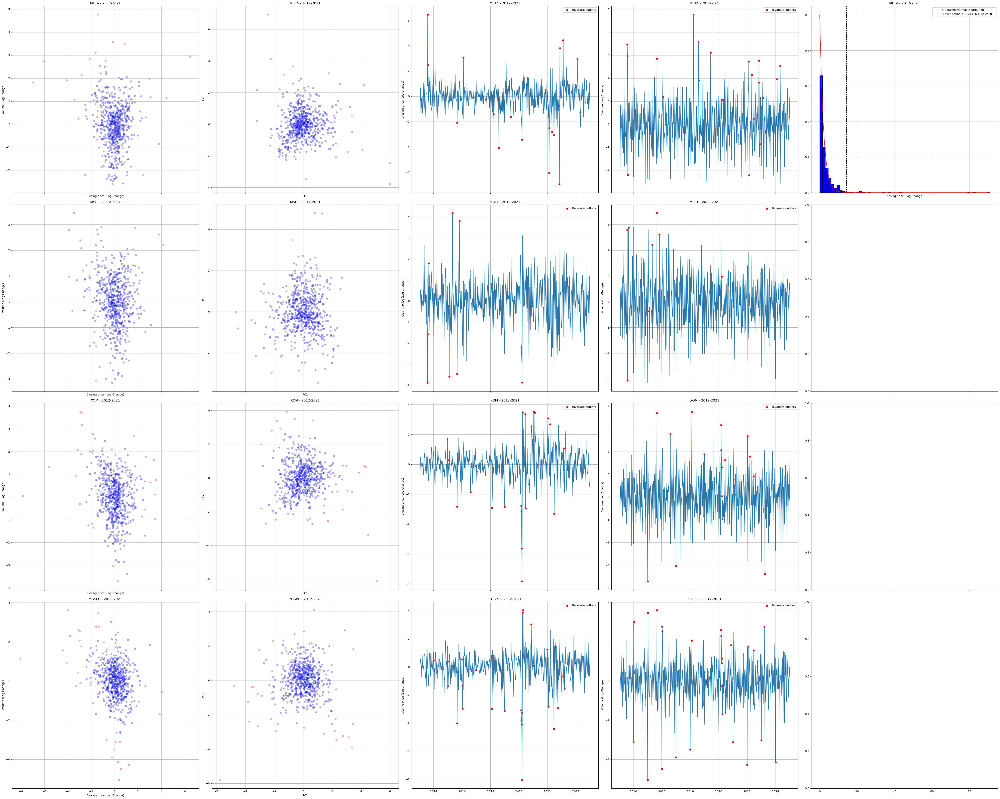

In [ ]:
pval_thr = 0.05
anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 8*5), sharex='col')

for j, s in enumerate(symbols):
    data = log_changes[["Close","Volume"]].loc[:, pd.IndexSlice[:,s]]

    # find PCs
    pca = PCA(n_components=2)
    pca_data = pca.fit_transform(data-np.median(data, axis=0))
    pca_data = pca_data/pca_data.std(axis=0)

    # calculta background dist
    IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
    std = IQR / 1.349
    cov = np.diag(std ** 2)
    mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

    pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=2)
    # print(pvals)
    chi2_thr = ss.chi2.ppf(1-
        BH_cutoff(pvals,pval_thr)
        ,df=2)
    anomalies[s] = mahalanobis_dist2 > chi2_thr

    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data.iloc[:,0],data.iloc[:,1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*anomalies[s]] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,0],pca_data[:,1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*anomalies[s]] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("PC1")
    ax.set_ylabel("PC2")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[anomalies[s]],log_changes["Close"].loc[anomalies[s],s], color = "red",label = "Bivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[anomalies[s]],log_changes["Volume"].loc[anomalies[s],s], color = "red",label = "Bivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    if j==0:
        ax = axes[j][4]
        ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
        x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
        pdf = ss.chi2.pdf(x, df = 2)
        ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
        ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
        ax.set_title(f"{s} - 2013-2024")
        ax.grid(True)
        ax.set_xlabel("Closing price (Log Change)")
        ax.legend()        

plt.tight_layout()
plt.show()

(8, 8)


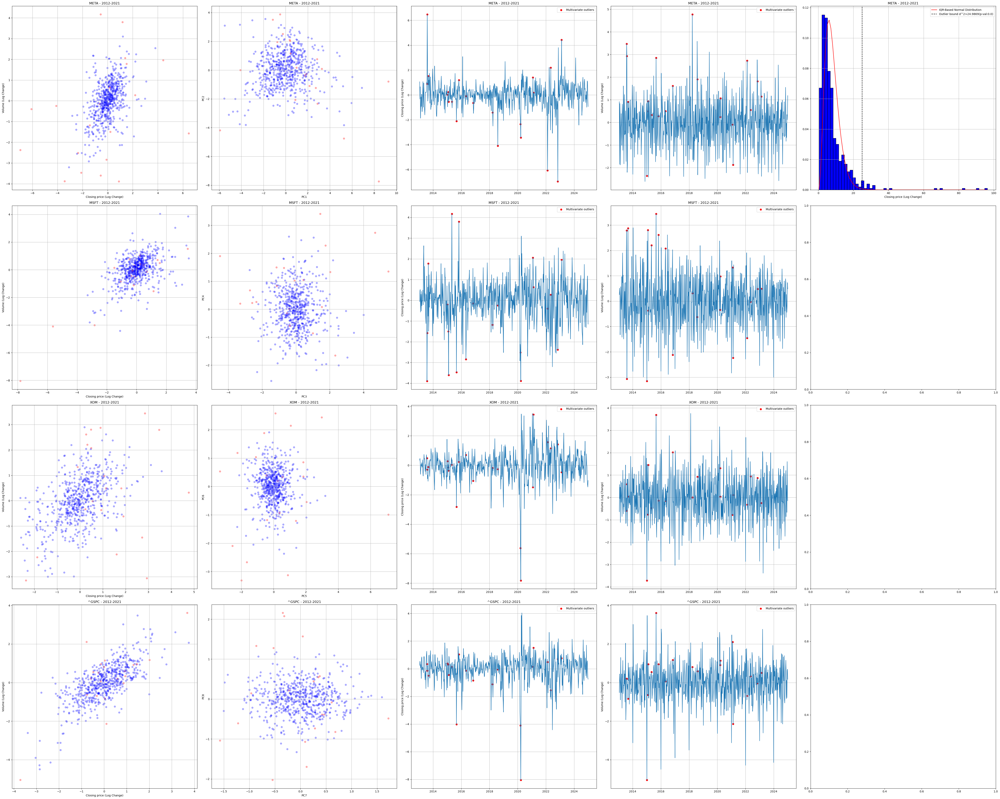

In [ ]:
pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)))

data = log_changes[["Close","Volume"]]

# find PCs
pca = PCA(n_components=len(data.columns))
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(data.values-np.median(data, axis=0), 75, axis=0) - np.percentile(data.values-np.median(data, axis=0), 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
cov = np.cov(data.T)
print(cov.shape)
mahalanobis_dist2 = np.sum((data.values-np.median(data, axis=0)) @ np.linalg.inv(cov) * (data.values-np.median(data, axis=0)), axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data.iloc[:,j*2],data.iloc[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    if j==0:
        ax = axes[j][4]
        ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
        x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
        pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
        ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
        ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
        ax.set_title(f"{s} - 2013-2024")
        ax.grid(True)
        ax.set_xlabel("Closing price (Log Change)")
        ax.legend()
        


plt.tight_layout()
plt.show()

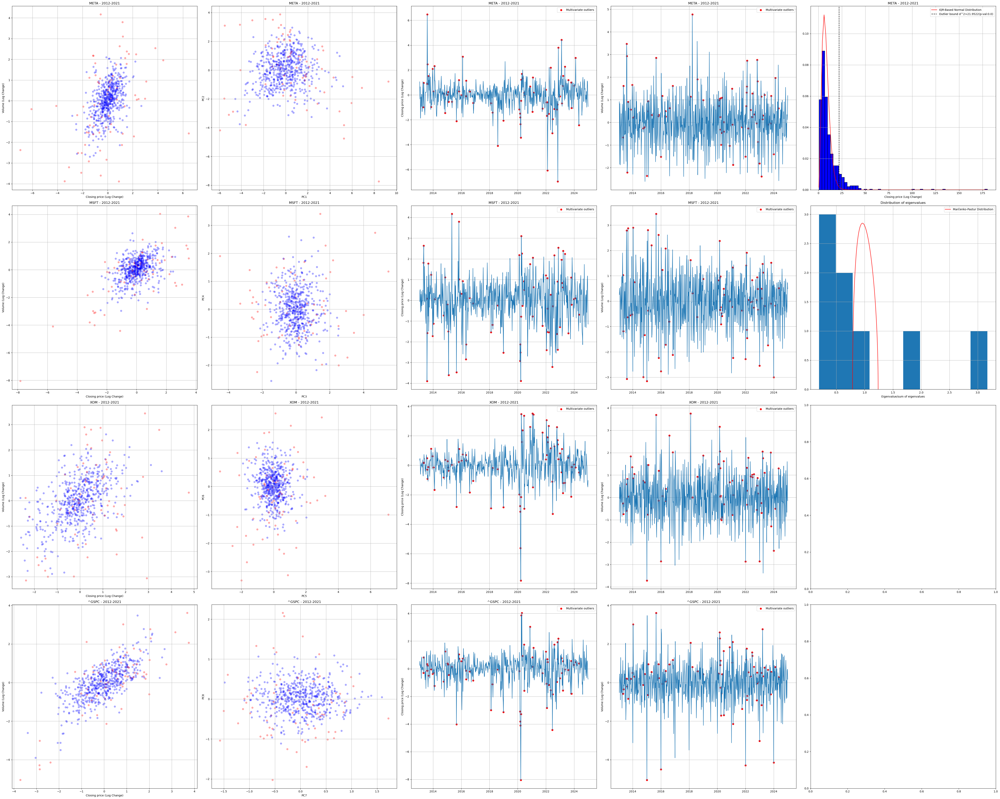

In [ ]:
pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)))

data = log_changes[["Close","Volume"]]

# find PCs
pca = PCA(n_components=len(data.columns))
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data.iloc[:,j*2],data.iloc[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    if j==0:
        ax = axes[j][4]
        ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
        x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
        pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
        ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
        ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
        ax.set_title(f"{s} - 2013-2024")
        ax.grid(True)
        ax.set_xlabel("Closing price (Log Change)")
        ax.legend()
    
    # PCA PVE
    if j==1:
        ax = axes[j][4]
        ax.hist(pca.explained_variance_)
        lambda_vals,mp_density= marcenko_pastur_density(*pca_data.shape)
        ax.plot(lambda_vals, mp_density, 'r-', label="Marčenko-Pastur Distribution")
        ax.set_title(f"Distribution of eigenvalues")
        ax.grid(True)
        ax.set_xlabel("Eigenvalue/sum of eigenvalues")
        ax.legend()
        


plt.tight_layout()
plt.show()

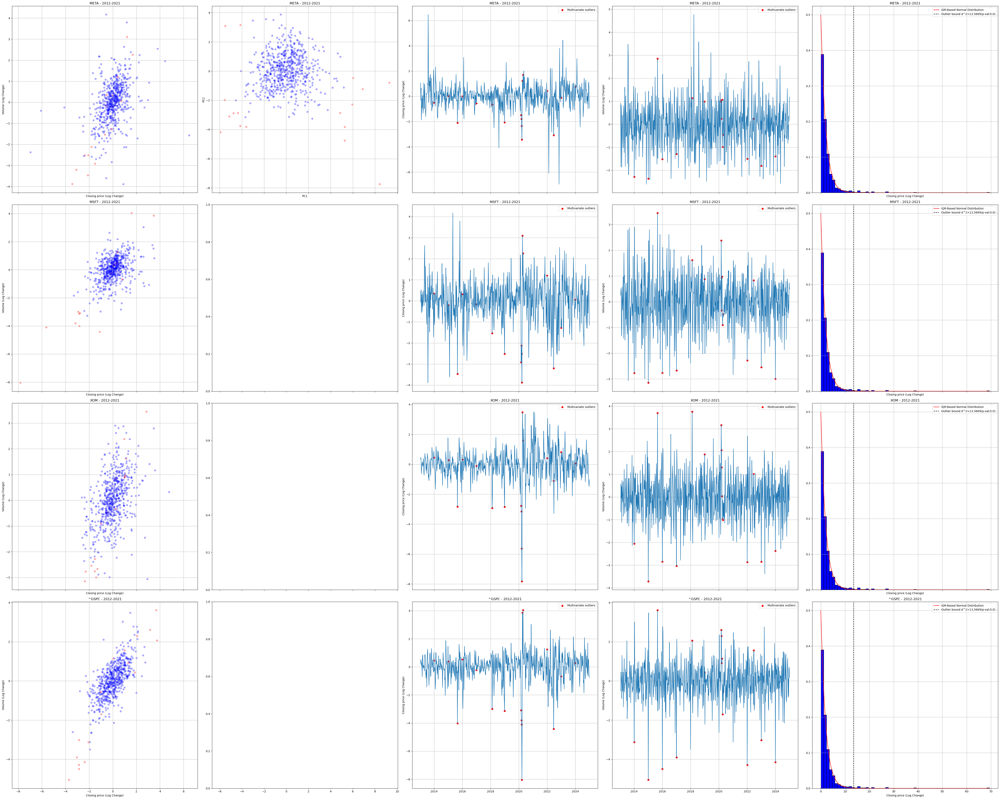

In [ ]:
pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)), sharex='col')

data = log_changes[["Close","Volume"]]

# find PCs
pca = PCA(n_components=2)
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data.iloc[:,j*2],data.iloc[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    if j==0:
        ax = axes[j][1]
        ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
            c = np.array(['blue','red'])[1*comb_anomalies] )
        ax.set_title(f"{s} - 2013-2024")
        ax.grid(True)
        ax.set_xlabel(f"PC{j*2+1}")
        ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{s} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    ax = axes[j][4]
    ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
    x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
    pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()


plt.tight_layout()
plt.show()

#### We now attempt to interpret some of these anomalies by looking at some world events that occured simultaneously:

High-price anomalies for each stock:

In [ ]:
for s in symbols:
    print(s)
    print(log_changes.index[high_anomalies[s]])

META
DatetimeIndex(['2013-08-04', '2013-08-11', '2014-02-09', '2016-02-07',
               '2019-02-10', '2022-03-27', '2022-11-20', '2023-02-12',
               '2023-05-07', '2024-02-11'],
              dtype='datetime64[ns]', name='Date', freq=None)
MSFT
DatetimeIndex(['2013-05-05', '2015-05-03', '2015-11-01', '2020-04-05'], dtype='datetime64[ns]', name='Date', freq=None)
XOM
DatetimeIndex(['2020-04-05', '2020-04-12', '2020-05-03', '2020-06-14',
               '2020-11-15', '2020-11-22', '2021-01-17', '2021-02-14',
               '2021-03-14', '2021-10-03', '2022-01-16', '2022-03-13',
               '2022-10-09', '2022-10-16', '2023-04-09'],
              dtype='datetime64[ns]', name='Date', freq=None)
^GSPC
DatetimeIndex(['2020-04-05', '2020-04-19', '2020-11-15', '2022-03-27'], dtype='datetime64[ns]', name='Date', freq=None)


We observe the following events
|Date | Event |
| ---- | ---- |
|2020-04-05 |         Rebound due to slower COVID-19 growth rate|

Low-price anomalies for each stock:

In [ ]:
for s in symbols:
    print(s)
    print(log_changes.index[low_anomalies[s]])

META
DatetimeIndex(['2018-04-01', '2018-08-05', '2020-03-15', '2020-03-22',
               '2022-02-13', '2022-02-20', '2022-05-01', '2022-06-19',
               '2022-09-25', '2022-11-06', '2024-05-05'],
              dtype='datetime64[ns]', name='Date', freq=None)
MSFT
DatetimeIndex(['2013-07-28', '2015-02-08', '2015-08-30', '2016-02-14',
               '2016-05-01', '2018-12-30', '2020-03-01', '2020-03-22',
               '2020-09-13', '2022-04-17', '2022-06-19', '2022-09-04',
               '2022-09-25'],
              dtype='datetime64[ns]', name='Date', freq=None)
XOM
DatetimeIndex(['2015-08-30', '2018-02-11', '2018-02-18', '2018-12-30',
               '2020-03-01', '2020-03-08', '2020-03-15', '2020-03-22',
               '2020-03-29', '2020-06-21', '2021-03-28', '2022-06-26',
               '2022-10-02', '2023-10-15'],
              dtype='datetime64[ns]', name='Date', freq=None)
^GSPC
DatetimeIndex(['2015-08-30', '2016-01-17', '2018-02-11', '2018-12-23',
               '2018-12

We observe the following events
|Date | Event |
| ---- | ---- |
|2015-08-30 |     China Market Crash|
|2020-03-16 |         COVID-19 Crash|
|2022-12-14 |     Inflation Cooldown|
|2018-12-19 |          Fed Rate Hike|


Anomalies in all stocks' prices and volume combined:

In [ ]:
log_changes.index[comb_anomalies]

DatetimeIndex(['2014-01-05', '2015-01-04', '2015-08-30', '2016-01-03',
               '2017-01-01', '2018-02-11', '2018-12-30', '2020-03-01',
               '2020-03-08', '2020-03-15', '2020-03-22', '2020-04-05',
               '2020-04-19', '2022-01-02', '2022-06-19', '2023-01-01',
               '2023-12-31'],
              dtype='datetime64[ns]', name='Date', freq=None)

Overlap with High-price Anomalies: 

In [ ]:
for s in symbols:
    print(s)
    print(sorted(set(log_changes.index[high_anomalies[s]]).intersection(log_changes.index[comb_anomalies])))

META
[]
MSFT
[Timestamp('2020-04-05 00:00:00')]
XOM
[Timestamp('2020-04-05 00:00:00')]
^GSPC
[Timestamp('2020-04-05 00:00:00'), Timestamp('2020-04-19 00:00:00')]


We observe the following events
|Date | Event |
| ---- | ---- |
|2015-08-30 |     China Market Crash|
|2016-06-24 |            Brexit Vote|
|2018-10-10 |      Market Correction|
|2020-03-16 |         COVID-19 Crash|
|2021-01-27 | GameStop Short Squeeze|
|2021-11-10 |  Inflation Surge Start|
|2022-12-14 |     Inflation Cooldown|
|2018-12-19 |          Fed Rate Hike|
|2019-07-31 |           Fed Rate Cut|
|2019-08-05 |     US-China Trade War|

Overlap with Low-price Anomalies for S&P500: 

In [ ]:
for s in symbols:
    print(s)
    print(sorted(set(log_changes.index[low_anomalies[s]]).intersection(log_changes.index[comb_anomalies])))

META
[Timestamp('2020-03-15 00:00:00'), Timestamp('2020-03-22 00:00:00'), Timestamp('2022-06-19 00:00:00')]
MSFT
[Timestamp('2015-08-30 00:00:00'), Timestamp('2018-12-30 00:00:00'), Timestamp('2020-03-01 00:00:00'), Timestamp('2020-03-22 00:00:00'), Timestamp('2022-06-19 00:00:00')]
XOM
[Timestamp('2015-08-30 00:00:00'), Timestamp('2018-02-11 00:00:00'), Timestamp('2018-12-30 00:00:00'), Timestamp('2020-03-01 00:00:00'), Timestamp('2020-03-08 00:00:00'), Timestamp('2020-03-15 00:00:00'), Timestamp('2020-03-22 00:00:00')]
^GSPC
[Timestamp('2015-08-30 00:00:00'), Timestamp('2018-02-11 00:00:00'), Timestamp('2018-12-30 00:00:00'), Timestamp('2020-03-01 00:00:00'), Timestamp('2020-03-08 00:00:00'), Timestamp('2020-03-15 00:00:00'), Timestamp('2020-03-22 00:00:00'), Timestamp('2022-06-19 00:00:00')]


We observe the following events
|Date | Event |
| ---- | ---- |
|2020-03-16 |         COVID-19 Crash|
|2021-01-27 | GameStop Short Squeeze|
|2021-11-10 |  Inflation Surge Start|
|2022-12-14 |     Inflation Cooldown|
|2018-12-19 |          Fed Rate Hike|
|2019-07-31 |           Fed Rate Cut|
|2019-08-05 |     US-China Trade War|

Overlap with Anomalies in S&P500's price and volume but not with just high/low-price anomalies: 

In [ ]:
set(log_changes.index[anomalies["^GSPC"]]).intersection(log_changes.index[comb_anomalies]) - set(log_changes.index[high_anomalies['^GSPC']]) - set(log_changes.index[low_anomalies['^GSPC']])

{Timestamp('2014-01-05 00:00:00'),
 Timestamp('2015-01-04 00:00:00'),
 Timestamp('2016-01-03 00:00:00'),
 Timestamp('2017-01-01 00:00:00'),
 Timestamp('2022-01-02 00:00:00'),
 Timestamp('2023-01-01 00:00:00'),
 Timestamp('2023-12-31 00:00:00')}

We observe the following events
|Date | Event |
| ---- | ---- |
|2015-08-30 |     China Market Crash|
|2016-06-24 |            Brexit Vote|
|2018-10-10 |      Market Correction|
|2020-03-16 |         COVID-19 Crash|
|2021-01-27 | GameStop Short Squeeze|
|2021-11-10 |  Inflation Surge Start|
|2022-12-14 |     Inflation Cooldown|
|2018-12-19 |          Fed Rate Hike|
|2019-07-31 |           Fed Rate Cut|
|2019-08-05 |     US-China Trade War|

# Simulated Examples (Sanity check of our approach)

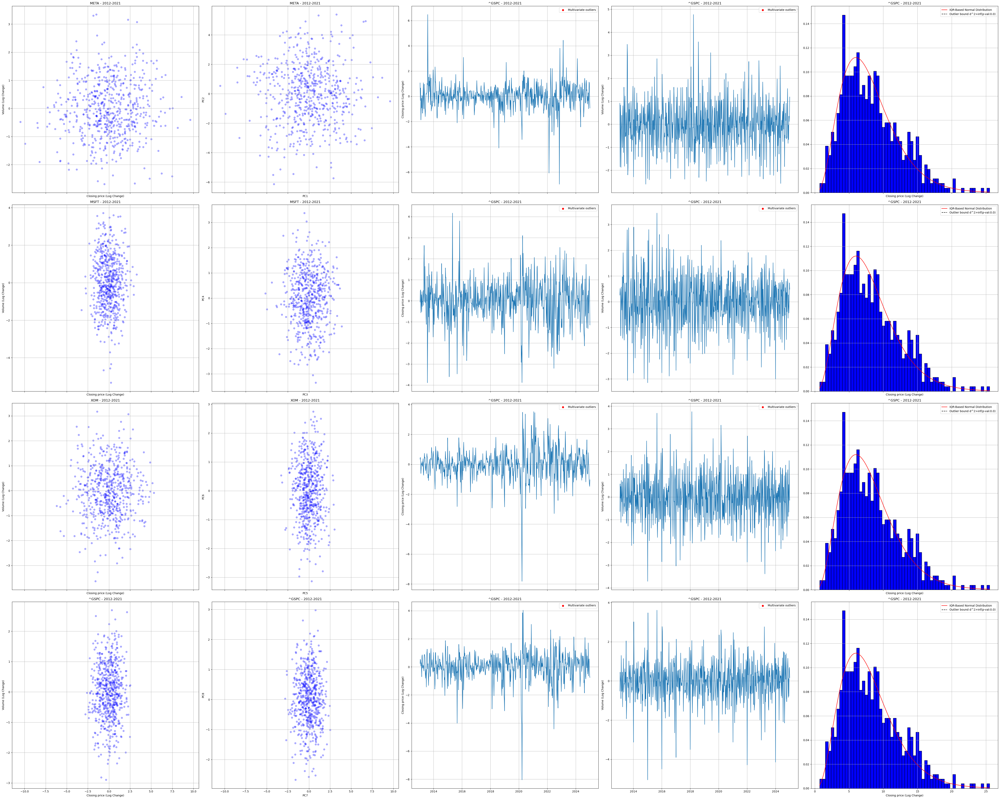

In [ ]:
# Sanity check, plot numbers from standard normal dist

pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)), sharex='col')

data = np.random.randn(*data.shape)*[3,1,1,1.5,2,1,1,1]

# find PCs
pca = PCA(n_components=data.shape[1])
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data[:,j*2],data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    ax = axes[j][4]
    ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
    x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
    pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()


plt.tight_layout()
plt.show()

As expected, no outliers were found

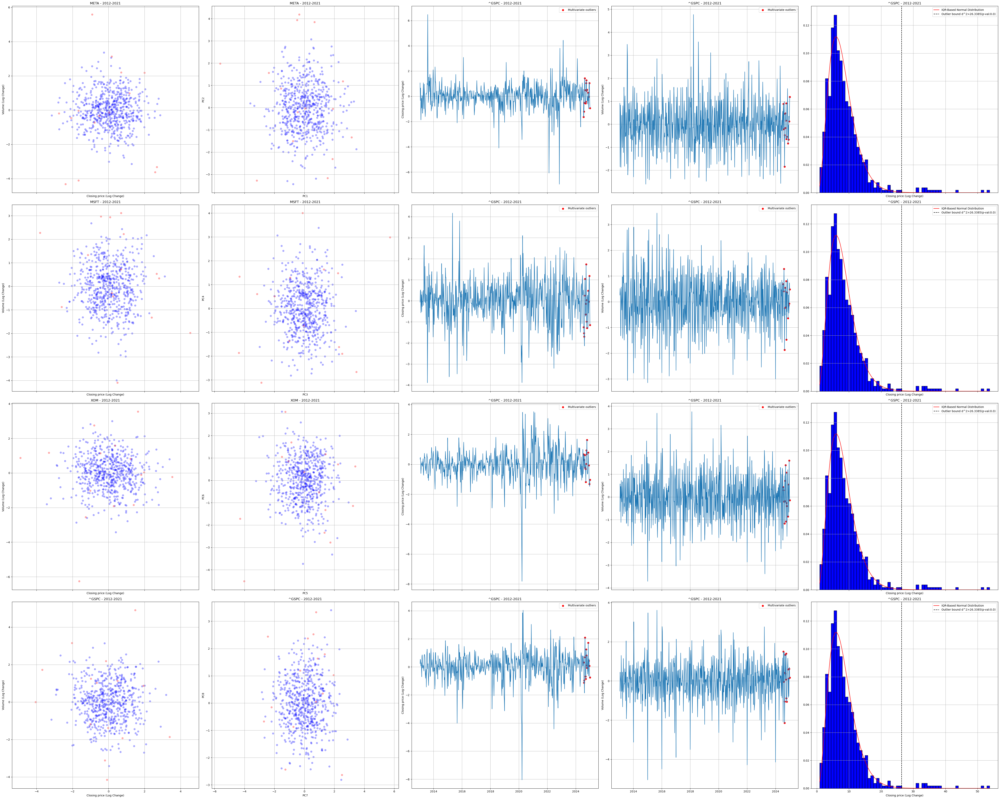

In [ ]:
# Simulated example with independent features, plot numbers from standard normal dist (m=0,std=1) + a wider normal dist (m=0,std = 10)

pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)), sharex='col')

data = np.vstack([np.random.randn(n,data.shape[1]),np.random.randn(data.shape[0]-n,data.shape[1])*2])

pca_data = PCA(n_components=data.shape[1])
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data[:,j*2],data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    ax = axes[j][4]
    ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
    x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
    pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()


plt.tight_layout()
plt.show()

The real outliers should mostly lie on the right side (as seen in col 3) since we append them to the simulated dataset.

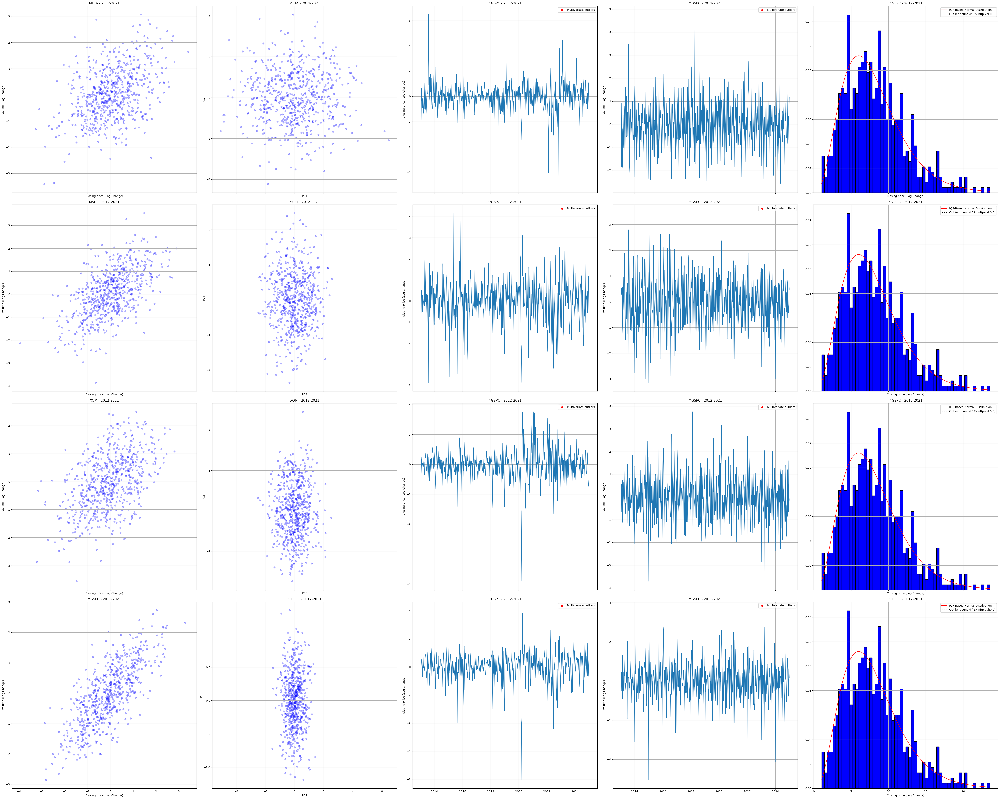

In [ ]:
# Simulate example with (multivar. normal dist) with correlation of features matching stocks price and volume (mean = 0)
pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)), sharex='col')

data = np.random.multivariate_normal(np.zeros(8), np.cov(log_changes[["Close","Volume"]].T), size=624)


pca_data = PCA(n_components=data.shape[1])
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data[:,j*2],data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    ax = axes[j][4]
    ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
    x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
    pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()


plt.tight_layout()
plt.show()

No outliers as expected.

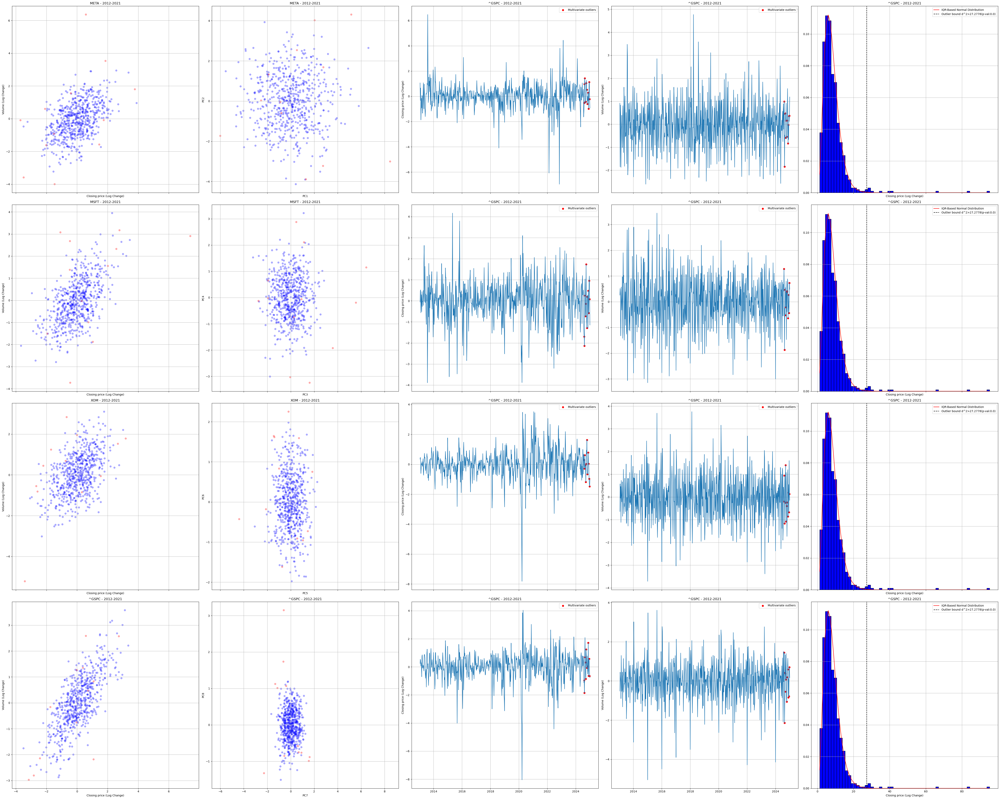

In [ ]:
# Simulate example (multivar. normal dist) with correlation of features matching stocks price and volume (mean = 0)
pval_thr = 0.05
comb_anomalies = dict()
fig, axes = plt.subplots(len(symbols),5, figsize=(10*5, 10*len(symbols)), sharex='col')
n=600
data = np.vstack([np.random.multivariate_normal(np.zeros(8), np.cov(log_changes[["Close","Volume"]].T), size=n),
            np.random.multivariate_normal(np.zeros(8), np.cov(log_changes[["Close","Volume"]].T), size=624-n)*2])

pca_data = PCA(n_components=data.shape[1])
pca_data = pca.fit_transform(data-np.median(data, axis=0))

# calculta background dist
IQR = np.percentile(pca_data, 75, axis=0) - np.percentile(pca_data, 25, axis=0)
std = IQR / 1.349
cov = np.diag(std ** 2)
mahalanobis_dist2 = np.sum(pca_data @ np.linalg.inv(cov) * pca_data, axis=1)

pvals = 1-ss.chi2.cdf(mahalanobis_dist2, df=pca_data.shape[1])
# print(pvals)
chi2_thr = ss.chi2.ppf(1-
    BH_cutoff(pvals,pval_thr)
    ,df=pca_data.shape[1])
comb_anomalies = mahalanobis_dist2 > chi2_thr

for j,s in enumerate(symbols):
    # Plot log changes
    ax = axes[j][0]
    ax.scatter(data[:,j*2],data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.set_ylabel("Volume (Log Change)")

    # Plot PCs
    ax = axes[j][1]
    ax.scatter(pca_data[:,j*2],pca_data[:,j*2+1], alpha = 0.3, 
        c = np.array(['blue','red'])[1*comb_anomalies] )
    ax.set_title(f"{s} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel(f"PC{j*2+1}")
    ax.set_ylabel(f"PC{j*2+2}")

    # plot log change outliers
    ax = axes[j][2]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Close"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Close"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Closing price (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # plot log change outliers
    ax = axes[j][3]
    ax.grid(True)
    ax.plot(log_changes.index,log_changes["Volume"].loc[:,s])
    ax.scatter(log_changes.index[comb_anomalies],log_changes["Volume"].loc[comb_anomalies,s], color = "red",label = "Multivariate outliers")
    ax.set_ylabel("Volume (Log Change)")
    ax.set_title(f"{t} - 2013-2024")
    ax.legend()

    # hist of Mahalanobis dist
    ax = axes[j][4]
    ax.hist(mahalanobis_dist2, bins=60, color='blue', edgecolor='black', density=True)
    x = np.linspace(mahalanobis_dist2.min(),mahalanobis_dist2.max(), 100)
    pdf = ss.chi2.pdf(x, df = pca_data.shape[1])
    ax.plot(x, pdf, 'r-', label="IQR-Based Normal Distribution")
    ax.axvline(chi2_thr, color='k', linestyle="--", label=f"Outlier bound d^2>{np.round(chi2_thr,4)}(p-val:{np.round(1-ss.norm.cdf(chi2_thr),3)})")
    ax.set_title(f"{t} - 2013-2024")
    ax.grid(True)
    ax.set_xlabel("Closing price (Log Change)")
    ax.legend()


plt.tight_layout()
plt.show()

The real outliers should mostly lie on the right side (as seen in col 3) since we append them to the simulated dataset.